# UXsim demo (for Google Colab)

This notebook demonstrates basic functionaries of [UXsim](https://github.com/toruseo/UXsim). 
For further details, please see the [GitHub repo](https://github.com/toruseo/UXsim) and the [technical documentation](https://toruseo.jp/UXsim/docs/index.html).

We show two examples: simple one and large-scale one.

## Simple Example

Here, we show a simple traffic simulation in a Y-shaped network.

First, install UXsim using pip and import the required modules.

In [1]:
!pip install uxsim

Defaulting to user installation because normal site-packages is not writeable



[notice] A new release of pip is available: 24.3.1 -> 25.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [2]:
from uxsim import *
import pandas as pd

C:\Users\Tomas\AppData\Roaming\Python\Python313\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


### Scenario Definition

First, we will define the main simulation `W`.
The unit of time is s (seconds) and the unit of length is m.

In [3]:
W = World(
    name="simple_demo",    # Scenario name. Can be blank. Used as the folder name for saving results.
    deltan=5,   # Simulation aggregation unit Δn. Defines how many vehicles are grouped together (i.e., platoon size) for computation. Computation cost is generally inversely proportional to deltan^2.
    tmax=1200,  # Total simulation time (s)
    print_mode=1, save_mode=1, show_mode=1,    # Various options. print_mode determines whether to print information. Usually set to 1, but recommended 0 when running multiple simulations automatically. save_mode determines if visualization results are saved. show_mode determines if visualization results are displayed. It's good to set show_mode=1 on Jupyter Notebook, otherwise recommended 0.
    random_seed=0    # Set the random seed. Specify if you want repeatable experiments. If not, set to None. On Jupyter Notebook, randomness might not always be consistent (requires a fix).
)

The simulation scenario (network structure and demand) is defined.
First, nodes are added, then links are defined to connect the nodes, and finally the traffic demand between the nodes is specified.
In this case, we define a simple Y-shaped merging network.

In [4]:
W.addNode("orig1", 0, 0) #Create a node. Parameters: node name, visualization x-coordinate, visualization y-coordinate
W.addNode("orig2", 0, 2)
W.addNode("merge", 1, 1)
W.addNode("dest", 2, 1)

W.addLink("link1", "orig1", "merge", length=1000, free_flow_speed=20, jam_density=0.2, merge_priority=0.5) # Create a link. Parameters: link name, start node, end node, length, free_flow_speed, jam_density, merge_priority during merging
W.addLink("link2", "orig2", "merge", length=1000, free_flow_speed=20, jam_density=0.2, merge_priority=2)
W.addLink("link3", "merge", "dest", length=1000, free_flow_speed=20, jam_density=0.2)

W.adddemand("orig1", "dest", 0, 1000, 0.4) # Create OD traffic demand. Parameters: origin node, destination node, start time, end time, demand flow rate
W.adddemand("orig2", "dest", 500, 1000, 0.6)

The network shape can be confirmed as follows.

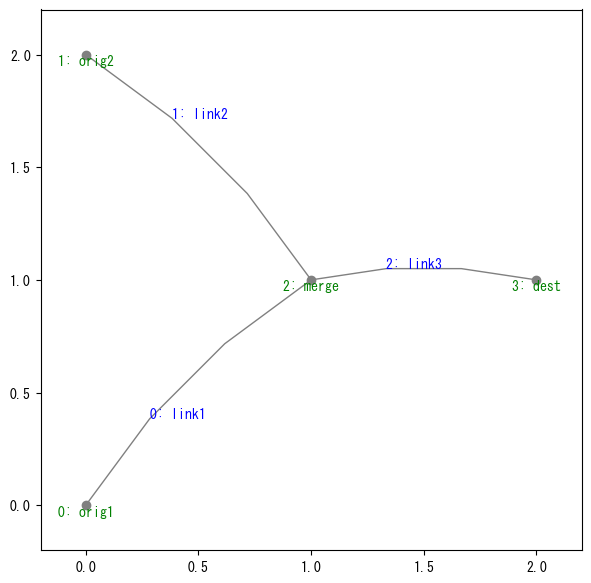

In [5]:
W.show_network()

### Simulation Execution

After defining the scenario, you can execute the simulation with `W.exec_simulation()`. This time, the simulation is run to the end. The simulation time, the number of vehicles in the network at that time, their average speed, and the computation time are displayed.

In [6]:
W.exec_simulation()

simulation setting:
 scenario name: simple_demo
 simulation duration:	 1200 s
 number of vehicles:	 700 veh
 total road length:	 3000 m
 time discret. width:	 5 s
 platoon size:		 5 veh
 number of timesteps:	 240
 number of platoons:	 140
 number of links:	 3
 number of nodes:	 4
 setup time:		 175.23 s
simulating...
      time| # of vehicles| ave speed| computation time
       0 s|        0 vehs|   0.0 m/s|     0.00 s
     600 s|      100 vehs|  17.5 m/s|     0.03 s
    1200 s|       25 vehs|  20.0 m/s|     0.07 s
 simulation finished


1

### Results

The `W.analyzer` class is responsible for analyzing the results.

A summary of the results can be printed below. Delay ratio is the ratio of delay time to total trip time, with a value close to zero indicating smooth traffic (when the shortest route can be traveled without congestion) and a larger value indicating congestion (when the shortest route is bypassed or congested).

In [7]:
W.analyzer.print_simple_stats()

results:
 average speed:	 13.8 m/s
 number of completed trips:	 675 / 700
 total travel time:		 96325.0 s
 average travel time of trips:	 142.7 s
 average delay of trips:	 42.7 s
 delay ratio:			 0.299
 total distance traveled:	 1416875.0 m


### Visualization of Results

#### Network-level

In order to see overall results, you can generate a gif animation of the traffic situation of the entire network.
By default, you can visualize the traffic situation per link, the traffic situation per section within a link (may not be very clear depending on the network geometry).
The thicker the width of the link, the greater the number and density of vehicles, and the darker the color, the lower the speed.
Note that the animation generation speed for large scenarios can be very slow.

 generating animation...


100%|██████████| 8/8 [00:00<00:00, 30.15it/s]


 generating animation...


100%|██████████| 10/10 [00:01<00:00,  7.16it/s]


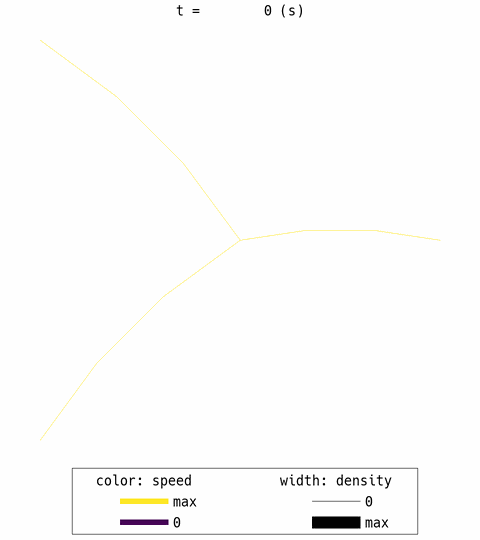

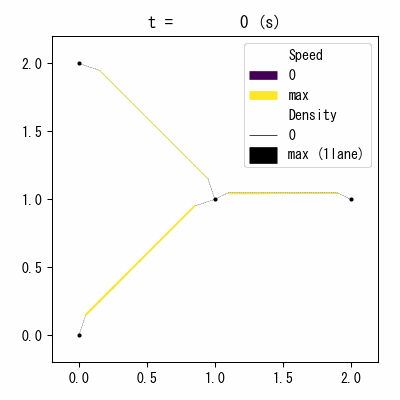

In [8]:
W.analyzer.network_anim(animation_speed_inverse=15, timestep_skip=30, detailed=0, network_font_size=0, figsize=(4,4))
W.analyzer.network_anim(detailed=1, network_font_size=0, figsize=(4,4))

from IPython.display import display, Image
with open("outsimple_demo/anim_network0.gif", "rb") as f:
    display(Image(data=f.read(), format='png'))
with open("outsimple_demo/anim_network1.gif", "rb") as f:
    display(Image(data=f.read(), format='png'))

You can also see the trajectories of some vehicles traveling through the network. This is quite slow.

 generating animation...


100%|██████████| 120/120 [00:06<00:00, 19.24it/s]


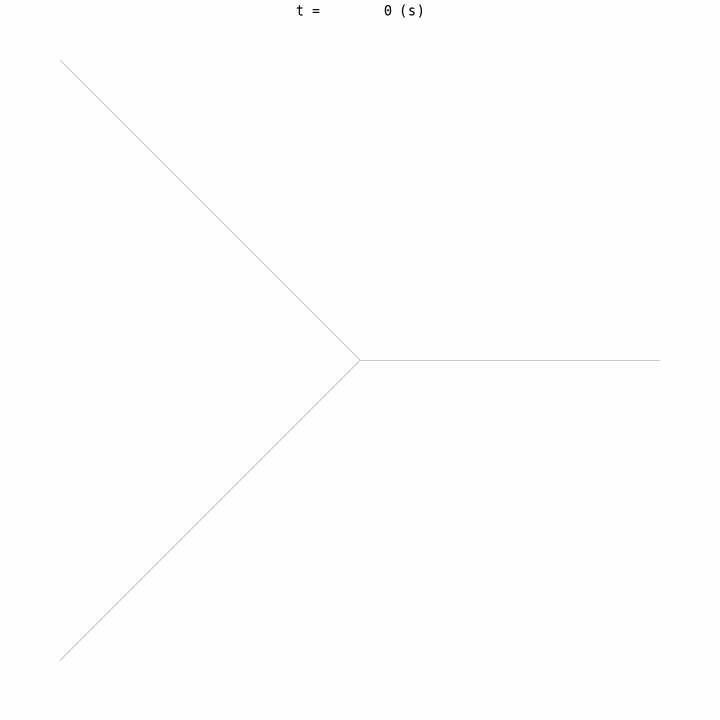

In [9]:
W.analyzer.network_fancy(animation_speed_inverse=15, sample_ratio=0.3, interval=3, trace_length=5)
with open("outsimple_demo/anim_network_fancy.gif", "rb") as f:
    display(Image(data=f.read(), format='png'))


If you don't need animation, you can quickly visualize snapshots of network traffic.

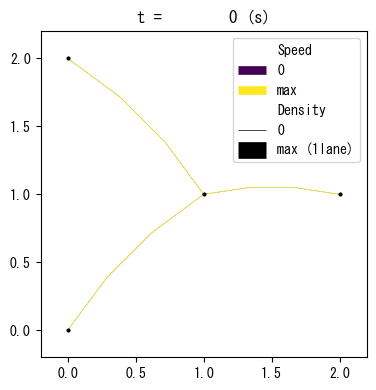

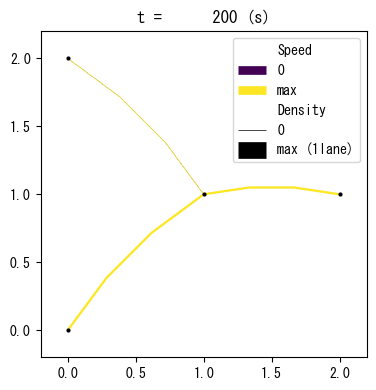

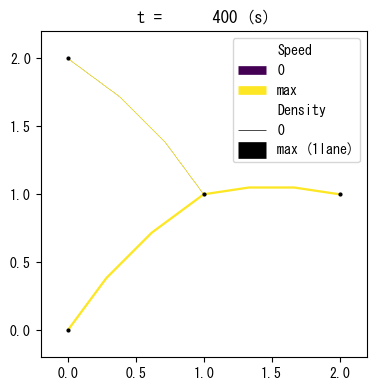

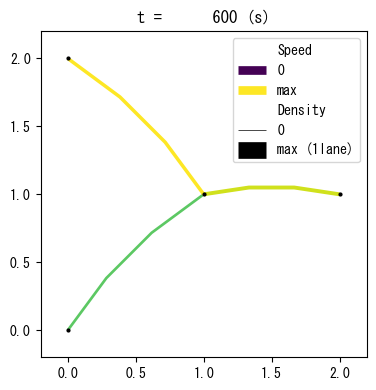

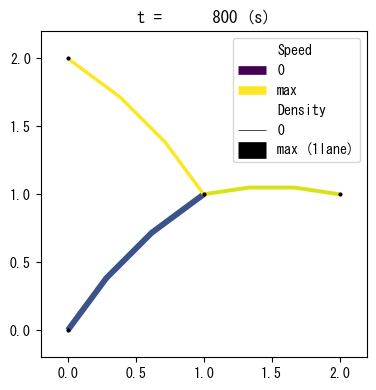

...

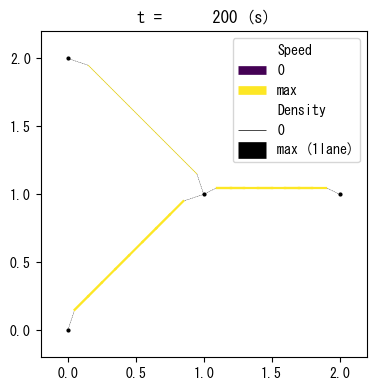

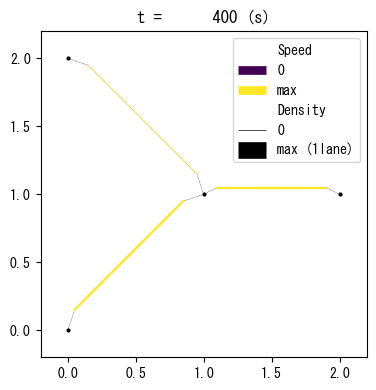

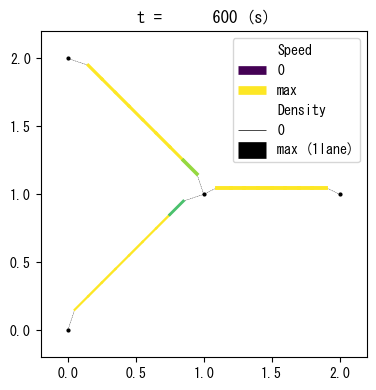

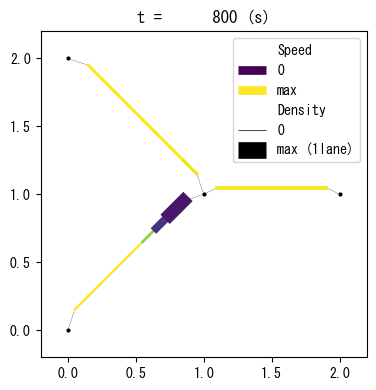

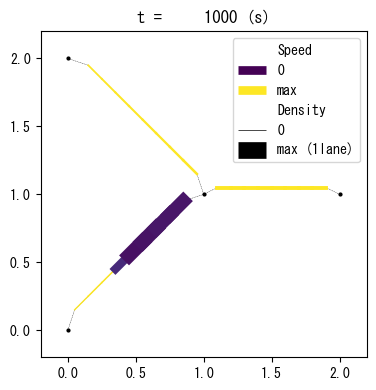

In [10]:
for t in list(range(0,W.TMAX,int(W.TMAX/6))):
    W.analyzer.network(t, detailed=0, network_font_size=0, figsize=(4,4))
for t in list(range(0,W.TMAX,int(W.TMAX/6))):
    W.analyzer.network(t, detailed=1, network_font_size=0, figsize=(4,4))

#### Link-level
In order to investigate detailed traffic dynamics, time-space diagrams (which is a standard visualization method in traffic flow theory) of density and trajectories for each link can be plotted as follows.
Ones for consecutive links can also be plotted.

 drawing traffic states...


  0%|          | 0/3 [00:00<?, ?it/s]

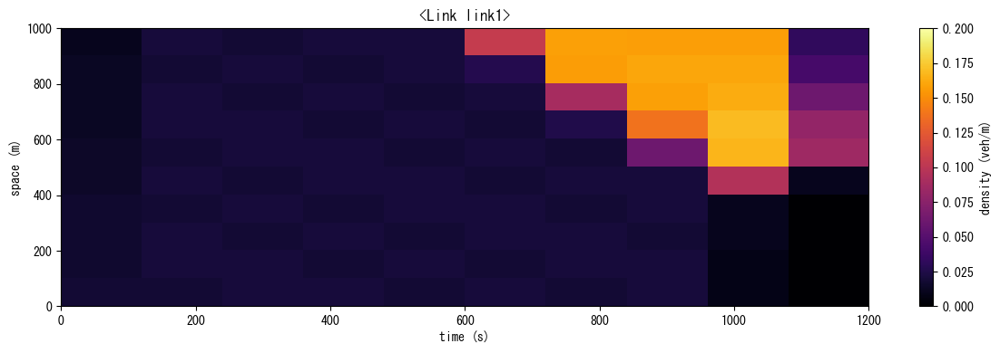

 33%|███▎      | 1/3 [00:00<00:00,  3.16it/s]

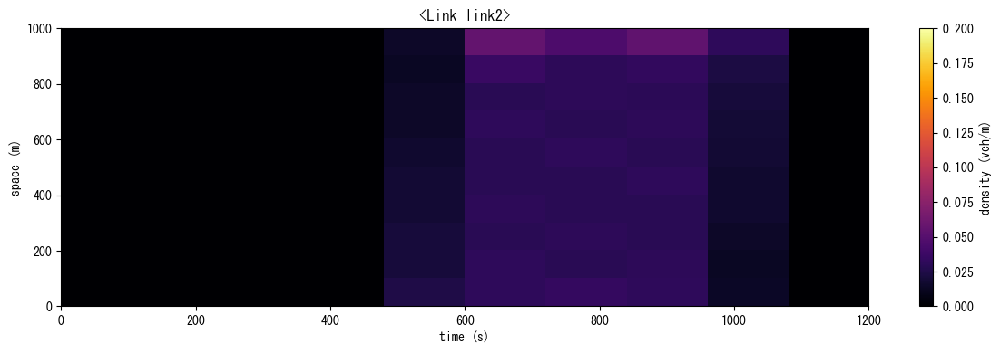

 67%|██████▋   | 2/3 [00:00<00:00,  3.19it/s]

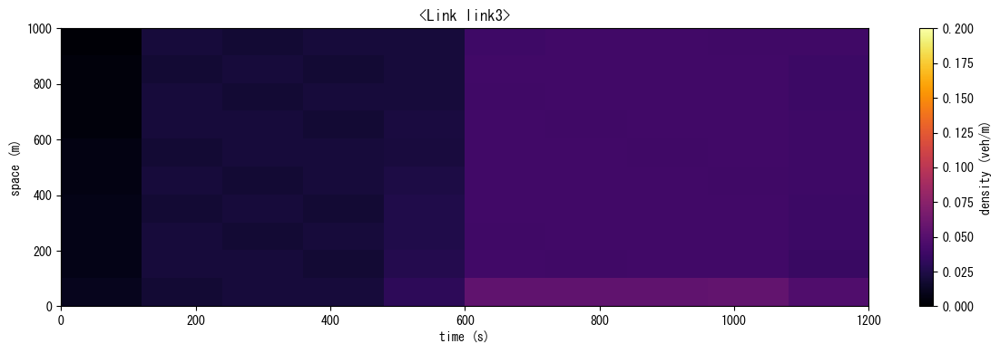

100%|██████████| 3/3 [00:00<00:00,  3.16it/s]


 drawing trajectories...


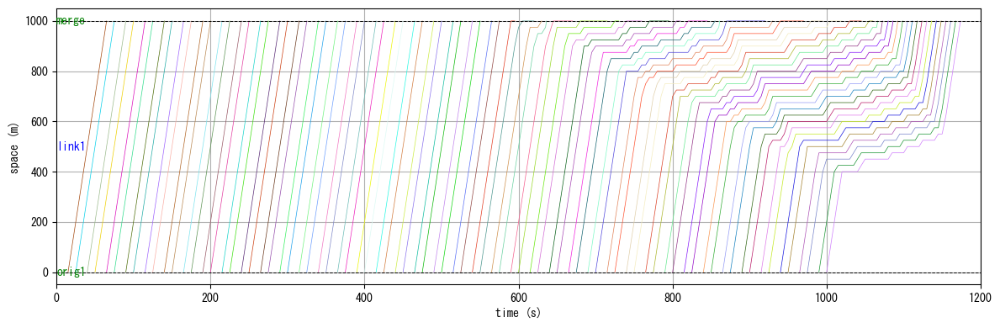

 drawing trajectories...


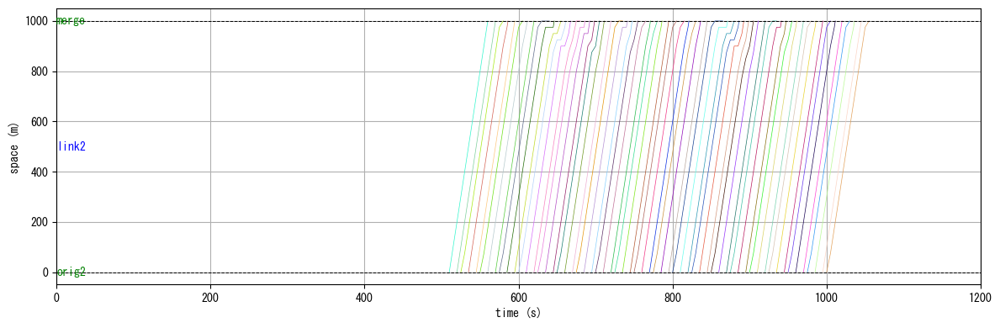

 drawing trajectories...


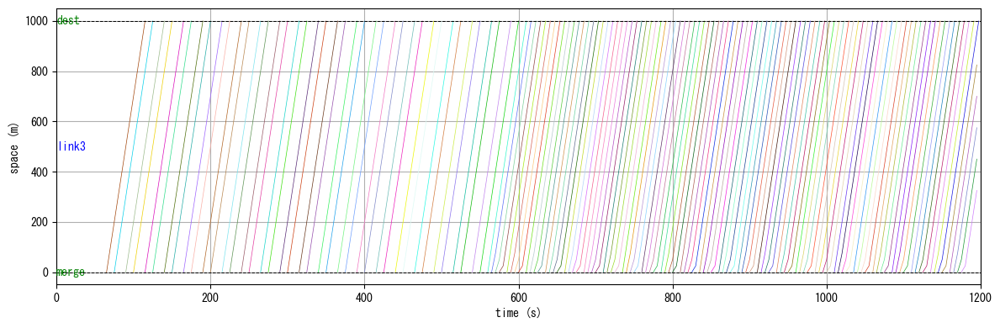

 drawing trajectories...


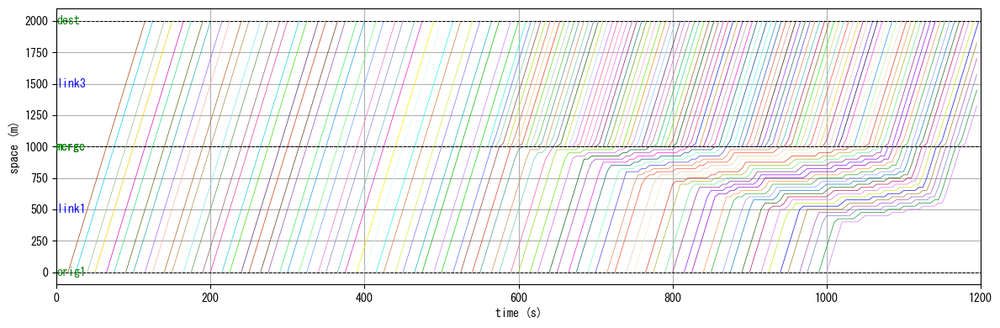

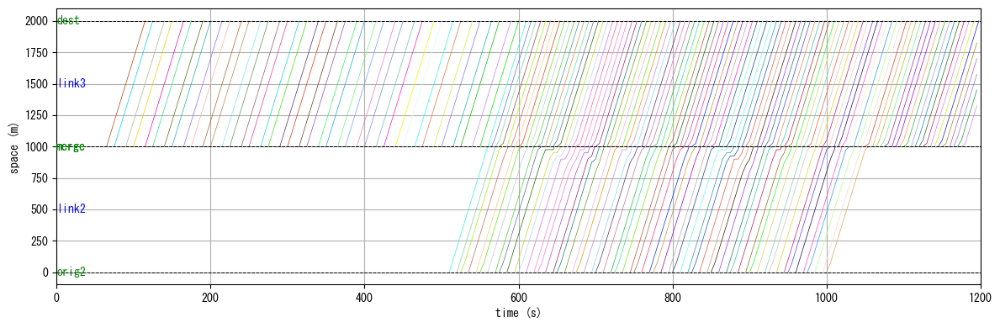

In [11]:
W.analyzer.time_space_diagram_density()
W.analyzer.time_space_diagram_traj()
W.analyzer.time_space_diagram_traj_links([["link1", "link3"], ["link2", "link3"]])

#### Area-level

The macroscopic fundamental diagram can also be generated

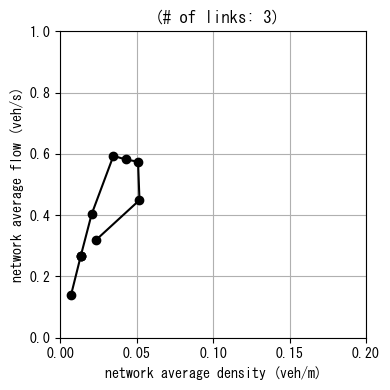

In [12]:
W.analyzer.macroscopic_fundamental_diagram()

### Numerical analysis

If you need to compute numbers, you can output the simulation results as pandas.Dataframe format.

In [13]:
#overall
df = W.analyzer.basic_to_pandas()
display(df)

#OD-specific traffic situation
df = W.analyzer.od_to_pandas()
display(df)

#MFD
df = W.analyzer.mfd_to_pandas()
display(df)

#link-level
df = W.analyzer.link_to_pandas()
display(df)

#within link
df = W.analyzer.link_traffic_state_to_pandas()
display(df)

#vehicle-level
df = W.analyzer.vehicles_to_pandas()
display(df)

,total_trips,completed_trips,total_travel_time,average_travel_time,total_delay,average_delay
0,700,675,96325.0,142.703704,28825.0,42.703704


,orig,dest,total_trips,completed_trips,free_travel_time,average_travel_time,stddiv_travel_time,shortest_distance,average_distance_traveled_per_veh,stddiv_distance_traveled_per_veh
0,orig1,dest,400,375,100.0,167.666667,89.388043,2000.0,2042.1875,169.26282
1,orig2,dest,300,300,100.0,111.500000,5.188127,2000.0,2000.0000,0.00000


,t,network_k,network_q
0,0,0.006944,0.138889


,link,start_node,end_node,traffic_volume,vehicles_remain,free_travel_time,average_travel_time,stddiv_travel_time,delay_ratio,length
0,link1,orig1,merge,400,0,50.0,128.125000,82.211776,2.562500,1000
1,link2,orig2,merge,300,0,50.0,55.208333,5.548868,1.104167,1000
2,link3,merge,dest,675,25,50.0,52.166667,2.477678,1.043333,1000


,link,t,x,delta_t,delta_x,q,k,v
0,link1,0,0.0,120,100.0,0.375000,0.018750,20.0
1,link1,0,100.0,120,100.0,0.333333,0.016667,20.0
2,link1,0,200.0,120,100.0,0.333333,0.016667,20.0
3,link1,0,300.0,120,100.0,0.333333,0.016667,20.0
4,link1,0,400.0,120,100.0,0.291667,0.014583,20.0
...,...,...,...,...,...,...,...,...
295,link3,1080,500.0,120,100.0,0.770833,0.038542,20.0
296,link3,1080,600.0,120,100.0,0.770833,0.038542,20.0
297,link3,1080,700.0,120,100.0,0.760417,0.038021,20.0
298,link3,1080,800.0,120,100.0,0.760417,0.038021,20.0


,name,dn,orig,dest,t,link,x,s,v
0,0,5,orig1,dest,15,link1,0.0,-1.0,20.0
1,0,5,orig1,dest,20,link1,100.0,-1.0,20.0
2,0,5,orig1,dest,25,link1,200.0,-1.0,20.0
3,0,5,orig1,dest,30,link1,300.0,-1.0,20.0
4,0,5,orig1,dest,35,link1,400.0,-1.0,20.0
...,...,...,...,...,...,...,...,...,...
4207,139,5,orig2,dest,1090,link3,600.0,225.0,20.0
4208,139,5,orig2,dest,1095,link3,700.0,225.0,20.0
4209,139,5,orig2,dest,1100,link3,800.0,-1.0,20.0
4210,139,5,orig2,dest,1105,link3,900.0,-1.0,20.0


Or save as CSV files.

In [14]:
W.analyzer.output_data()

## Large-scale Example

Noe let's see large-scale scenario with a lot of vehicles in a large network.

If you haven't, please install UXsim first.

In [15]:
!pip install uxsim

Defaulting to user installation because normal site-packages is not writeable



[notice] A new release of pip is available: 24.3.1 -> 25.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [16]:
from uxsim import *
import pandas as pd

At this time, we automatically generate a grid-shaped network.

In [17]:
W = World(
    name="large",
    deltan=5,
    tmax=7200,
    print_mode=1, save_mode=1, show_mode=0,
    random_seed=0,
)

# create nodes on an imax x jmax grid.
imax = 11
jmax = 11
nodes = {}
for i in range(imax):
    for j in range(jmax):
        nodes[i,j] = W.addNode(f"n{(i,j)}", i, j)

# create links between neighborhood nodes
links = {}
for i in range(imax):
    for j in range(jmax):
        if i != imax-1:
            links[i,j,i+1,j] = W.addLink(f"l{(i,j,i+1,j)}", nodes[i,j], nodes[i+1,j], length=1000, free_flow_speed=20, jam_density=0.2)
        if i != 0:
            links[i,j,i-1,j] = W.addLink(f"l{(i,j,i-1,j)}", nodes[i,j], nodes[i-1,j], length=1000, free_flow_speed=20, jam_density=0.2)
        if j != jmax-1:
            links[i,j,i,j+1] = W.addLink(f"l{(i,j,i,j+1)}", nodes[i,j], nodes[i,j+1], length=1000, free_flow_speed=20, jam_density=0.2)
        if j != 0:
            links[i,j,i,j-1] = W.addLink(f"l{(i,j,i,j-1)}", nodes[i,j], nodes[i,j-1], length=1000, free_flow_speed=20, jam_density=0.2)

# generate demand from each boundary node to the other boundary nodes
demand_flow = 0.035
demand_duration = 3600
for n1 in [(0,j) for j in range(jmax)]:
    for n2 in [(imax-1,j) for j in range(jmax)]:
        W.adddemand(nodes[n2], nodes[n1], 0, demand_duration, demand_flow)
        W.adddemand(nodes[n1], nodes[n2], 0, demand_duration, demand_flow)
for n1 in [(i,0) for i in range(imax)]:
    for n2 in [(i,jmax-1) for i in range(imax)]:
        W.adddemand(nodes[n2], nodes[n1], 0, demand_duration, demand_flow)
        W.adddemand(nodes[n1], nodes[n2], 0, demand_duration, demand_flow)

W.show_network(network_font_size=0)

Note that each link is 1 km long, so this is a 10 km x 10 km area. And the total number of vehicles is about 60000.

In [18]:
W.exec_simulation()

simulation setting:
 scenario name: large
 simulation duration:	 7200 s
 number of vehicles:	 60500 veh
 total road length:	 440000 m
 time discret. width:	 5 s
 platoon size:		 5 veh
 number of timesteps:	 1440
 number of platoons:	 12100
 number of links:	 440
 number of nodes:	 121
 setup time:		 60.86 s
simulating...
      time| # of vehicles| ave speed| computation time
       0 s|        0 vehs|   0.0 m/s|     0.00 s
     600 s|     8320 vehs|  10.4 m/s|     2.92 s
    1200 s|    15850 vehs|  11.3 m/s|     7.69 s
    1800 s|    19450 vehs|   9.7 m/s|    13.13 s
    2400 s|    22375 vehs|   8.2 m/s|    18.61 s
    3000 s|    25015 vehs|   7.3 m/s|    24.12 s
    3600 s|    30140 vehs|   5.5 m/s|    29.51 s
    4200 s|    25415 vehs|   6.3 m/s|    34.60 s
    4800 s|    18465 vehs|   8.4 m/s|    38.99 s
    5400 s|    10060 vehs|  12.9 m/s|    42.23 s
    6000 s|     1010 vehs|  19.4 m/s|    43.73 s
    6600 s|        0 vehs|   0.0 m/s|    43.90 s
    7200 s|        0 vehs|   0.0 m

1

Let's visualize the network traffic states. You can see complicated traffic pattern emerges in the network.

 generating animation...


100%|██████████| 48/48 [00:06<00:00,  7.94it/s]


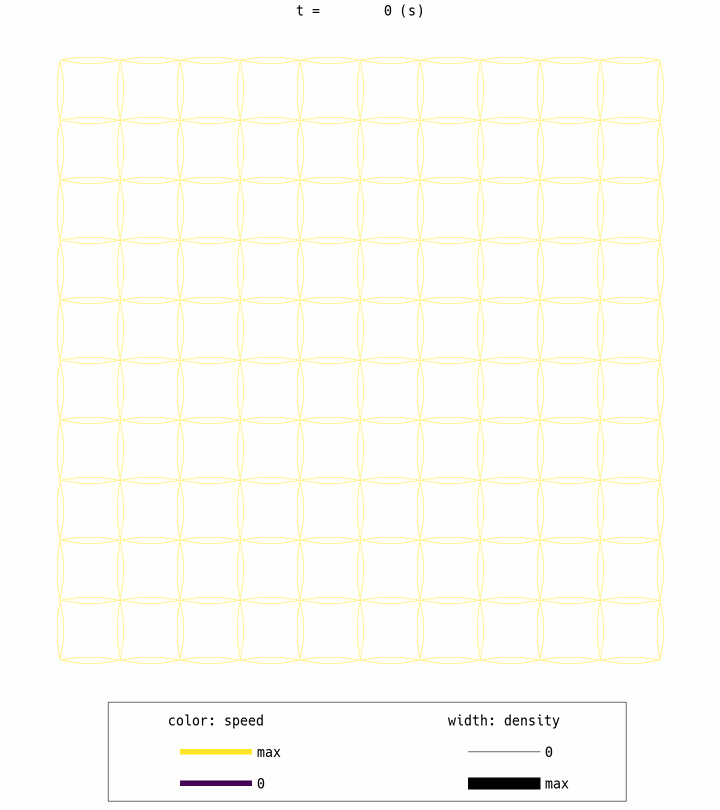

In [19]:
W.analyzer.network_anim(animation_speed_inverse=15, timestep_skip=30, detailed=0, network_font_size=0, figsize=(6,6))

from IPython.display import display, Image
with open("outlarge/anim_network0.gif", "rb") as f:
    display(Image(data=f.read(), format='png'))

 generating animation...


100%|██████████| 720/720 [00:54<00:00, 13.13it/s]


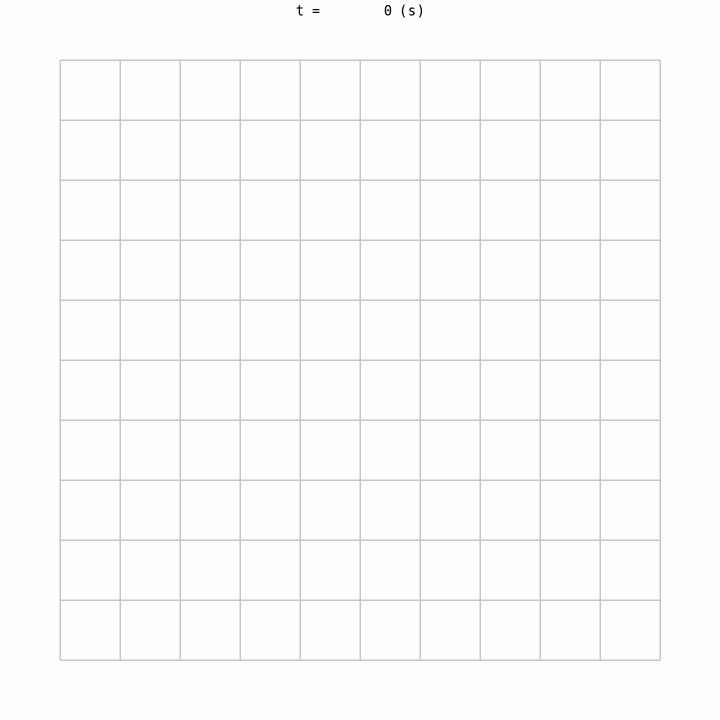

In [20]:
W.analyzer.network_fancy(animation_speed_inverse=15, sample_ratio=0.3, interval=3, trace_length=5)

with open("outlarge/anim_network_fancy.gif", "rb") as f:
    display(Image(data=f.read(), format='png'))